In [190]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from IPython.display import HTML

from hexapod_biomechanics.load_data import C3DMan
from hexapod_force_modeling.mlp_model import BasicMLP
from hexapod_biomechanics.kinematics import AnkleFrame
from hexapod_biomechanics.forces import HexKistler
from hexapod_biomechanics.inverse_dynamics import AnkleID
from hexapod_biomechanics.visualize import animate_grf, animate_ankle_kinematics, animate_perturbation
from hexapod_biomechanics.utils import axis_difference

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load Data

### Init C3D Managers and Print Labels

In [191]:
static_file = "../data/static_01.c3d"
trip_file = "../data/hex250811101244_trip1_nom_fwd.c3d"
# trip_file = "../data/hex250811101244_trip2_pert_50pct_rev.c3d"
# trip_file = "../data/hex250811101244_trip3_pert_50pct_fwd.c3d"

side = 1 # left / rev
sex = "m"

Static = C3DMan(static_file)
Trip = C3DMan(trip_file)

Static.print_data_labels()

C3D file opened from path: ../data/static_01.c3d
C3D file opened from path: ../data/hex250811101244_trip1_nom_fwd.c3d
---------- ANALOG CHANNELS ----------
('Bertec Force Plate [1]', 'Force.Fx1')
('Bertec Force Plate [1]', 'Force.Fy1')
('Bertec Force Plate [1]', 'Force.Fz1')
('Bertec Force Plate [1]', 'Moment.Mx1')
('Bertec Force Plate [1]', 'Moment.My1')
('Bertec Force Plate [1]', 'Moment.Mz1')
('Bertec Force Plate [2]', 'Force.Fx2')
('Bertec Force Plate [2]', 'Force.Fy2')
('Bertec Force Plate [2]', 'Force.Fz2')
('Bertec Force Plate [2]', 'Moment.Mx2')
('Bertec Force Plate [2]', 'Moment.My2')
('Bertec Force Plate [2]', 'Moment.Mz2')
('AMTI 400600     [37]', 'Force.Fx3')
('AMTI 400600     [37]', 'Force.Fy3')
('AMTI 400600     [37]', 'Force.Fz3')
('AMTI 400600     [37]', 'Moment.Mx3')
('AMTI 400600     [37]', 'Moment.My3')
('AMTI 400600     [37]', 'Moment.Mz3')
('AMTI 400600     [38]', 'Force.Fx4')
('AMTI 400600     [38]', 'Force.Fy4')
('AMTI 400600     [38]', 'Force.Fz4')
('AMTI 400600

### Extract Marker Data

In [192]:
hex_marker_labels = [
    'hexapod:Hexapod00',
    'hexapod:Hexapod10',
    'hexapod:Hexapod11'
]

bio_marker_labels = [
    "C0111085:RMANK", # right medial malleolus (0)
    "C0111085:LMANK", # left medial malleolus (1)
    "C0111085:RANK", # right lateral malleolus (2)
    "C0111085:LANK", # left lateral malleolus (3)
    "C0111085:RMKNE", # right medial condyle (4)
    "C0111085:LMKNE", # left medial condyle (5)
    "C0111085:RKNE", # right lateral condyle (6)
    "C0111085:LKNE", # left lateral condyle (7)
    "C0111085:RTIBA", # right shank cluster 1 (8)
    "C0111085:RTIBB", # right shank cluster 2 (9)
    "C0111085:RTIBC", # right shank cluster 3 (10)
    "C0111085:LTIBA", # left shank cluster 1 (11)
    "C0111085:LTIBB", # left shank cluster 2 (12)
    "C0111085:LTIBC", # left shank cluster 3 (13)
    "C0111085:RHEE", # right foot cluster 1 (14)
    "C0111085:RMT1", # right foot cluster 2 (15)
    "C0111085:RMT5", # right foot cluster 3 (16)
    "C0111085:LHEE", # left foot cluster 1 (17)
    "C0111085:LMT1", # left foot cluster 2 (18)
    "C0111085:LMT5", # left foot cluster 3 (19)

    "C0111085:RASI",
    "C0111085:LASI",
    "C0111085:RPSI",
    "C0111085:LPSI",
    "C0111085:RTHI",
    "C0111085:RTHIA",
    "C0111085:RTHIB",
    "C0111085:RTHIC",
    "C0111085:LTHI",
    "C0111085:LTHIA",
    "C0111085:LTHIB",
    "C0111085:LTHIC",
    "C0111085:LTHID",
    "C0111085:RTOE",
    "C0111085:LTOE"
]

static_hex_markers, _ = Static.get_points(hex_marker_labels)
static_bio_markers, t_static = Static.get_points(bio_marker_labels)
trip_hex_markers, _ = Trip.get_points(hex_marker_labels)
trip_bio_markers, t_trip = Trip.get_points(bio_marker_labels)

### Extract Analog Data

In [193]:
force_labels = [
    ('Kistler Force Plate 2.0.0.0::Raw [41]', 'Raw.FX12'),
    ('Kistler Force Plate 2.0.0.0::Raw [41]', 'Raw.FX34'),
    ('Kistler Force Plate 2.0.0.0::Raw [41]', 'Raw.FY14'),
    ('Kistler Force Plate 2.0.0.0::Raw [41]', 'Raw.FY23'),
    ('Kistler Force Plate 2.0.0.0::Raw [41]', 'Raw.FZ1'),
    ('Kistler Force Plate 2.0.0.0::Raw [41]', 'Raw.FZ2'),
    ('Kistler Force Plate 2.0.0.0::Raw [41]', 'Raw.FZ3'),
    ('Kistler Force Plate 2.0.0.0::Raw [41]', 'Raw.FZ4')
]
accel_labels = [
    ('Generic Analog::Electric Potential [33,1]', 'Electric Potential.X'),
    ('Generic Analog::Electric Potential [33,2]', 'Electric Potential.Y'),
    ('Generic Analog::Electric Potential [33,3]', 'Electric Potential.Z'),
    ('Generic Analog::Electric Potential [34,1]', 'Electric Potential.X'),
    ('Generic Analog::Electric Potential [34,2]', 'Electric Potential.Y'),
    ('Generic Analog::Electric Potential [34,3]', 'Electric Potential.Z'),
    ('Generic Analog::Electric Potential [35,1]', 'Electric Potential.X'),
    ('Generic Analog::Electric Potential [35,2]', 'Electric Potential.Y'),
    ('Generic Analog::Electric Potential [35,3]', 'Electric Potential.Z'),
    ('Generic Analog::Electric Potential [36,1]', 'Electric Potential.X'),
    ('Generic Analog::Electric Potential [36,2]', 'Electric Potential.Y'),
    ('Generic Analog::Electric Potential [36,3]', 'Electric Potential.Z')
]

trip_forces, t_forces = Trip.get_analogs(force_labels)
trip_accels, _ = Trip.get_analogs(accel_labels)

# Remove Induced Forces

### Predict Induced Forces from Accelerations

In [194]:
model_file = "../models/mlp_general.pth"
window_size = 500
step_size = 50
accel_chans = len(accel_labels)
force_chans = len(force_labels)

input_dim = accel_chans*window_size
output_dim = force_chans*window_size

ForcePredictor = BasicMLP(input_dim=input_dim, output_dim=output_dim)
ForcePredictor.load_weights(model_file)
induced_forces = ForcePredictor.predict_segments(
    inputs=[trip_accels],
    step_size=step_size
)[0]
trip_forces_iso = trip_forces - induced_forces

### Display Predicted Forces

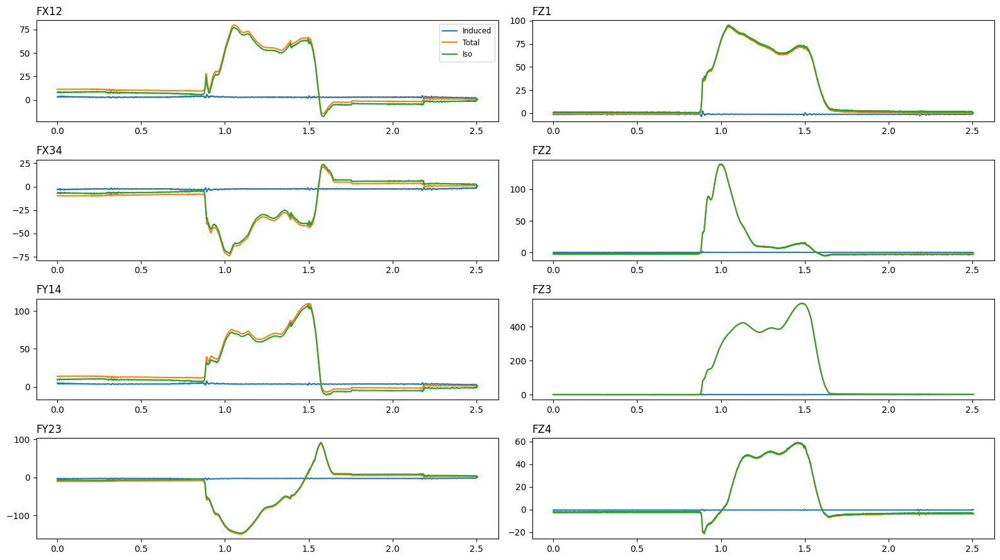

In [195]:
fig = plt.figure(figsize=(16,9), facecolor='white')
fig.subplots_adjust(left=0.05, right=0.95, top=0.92, bottom=0.05, wspace=0.15)
gs = gridspec.GridSpec(4, 2)

ax_fx12 = fig.add_subplot(gs[0, 0])
ax_fx34 = fig.add_subplot(gs[1, 0])
ax_fy14 = fig.add_subplot(gs[2, 0])
ax_fy23 = fig.add_subplot(gs[3, 0])
ax_fz1 = fig.add_subplot(gs[0, 1])
ax_fz2 = fig.add_subplot(gs[1, 1])
ax_fz3 = fig.add_subplot(gs[2, 1])
ax_fz4 = fig.add_subplot(gs[3, 1])

for i, (ax, name) in enumerate(zip(
    [ax_fx12, ax_fx34, ax_fy14, ax_fy23, ax_fz1, ax_fz2, ax_fz3, ax_fz4],
    ['FX12', 'FX34', 'FY14', 'FY23', 'FZ1', 'FZ2', 'FZ3', 'FZ4']
)):
    ax.plot(t_forces, induced_forces[:, i], label='Induced')
    ax.plot(t_forces, trip_forces[:, i], label='Total')
    ax.plot(t_forces, trip_forces_iso[:, i], label='Iso')
    ax.set_title(name, loc='left')
    if i == 0:
        ax.legend(loc='upper right', fontsize='small')

plt.tight_layout()
plt.show()

# Compute Forces/Moments and GRF

In [207]:
Kist = HexKistler(cluster_hex_static=static_hex_markers)

trip_grf = Kist.process_forces(
    cluster_hex=trip_hex_markers,
    fx12=trip_forces_iso[:, 0],
    fx34=trip_forces_iso[:, 1],
    fy14=trip_forces_iso[:, 2],
    fy23=trip_forces_iso[:, 3],
    fz1=trip_forces_iso[:, 4],
    fz2=trip_forces_iso[:, 5],
    fz3=trip_forces_iso[:, 6],
    fz4=trip_forces_iso[:, 7]
)
corners, sensors = Kist.track_plate()
kistler_rot = Kist.locate_rot_axis(trip_hex_markers)
kist_origin_base = Kist.T_KG_neut[:3, 3]

# Animate Resulting GRF

In [197]:
anim = animate_grf(
    t=t_forces,
    forces=trip_grf['force'],
    COP=trip_grf['COP'],
    moment_free=trip_grf['moment_free'],
    corners=corners,
    sensors=sensors,
    kist_origin_base=kist_origin_base,
    side=side,
    markers=trip_bio_markers,
    speed=0.5
)

HTML(anim.to_jshtml())

# Configure Ankle Coordinate System and Compute Kinematics

#### Right Ankle (forward trip):

In [198]:
if side == 1:
    MM_idx = 0
    LM_idx = 2
    MC_idx = 4
    LC_idx = 6
    CALC_idx = 14
    M1_idx = 15
    M5_idx = 16
    cluster_S_idx = list(range(8,11))
elif side == -1:
    MM_idx = 1
    LM_idx = 3
    MC_idx = 5
    LC_idx = 7
    CALC_idx = 17
    M1_idx = 18
    M5_idx = 19
    cluster_S_idx = list(range(11,14))

Ankle = AnkleFrame(
    side=side,
    MM_static=static_bio_markers[:,MM_idx,:],
    LM_static=static_bio_markers[:,LM_idx,:],
    MC_static=static_bio_markers[:,MC_idx,:],
    LC_static=static_bio_markers[:,LC_idx,:],
    CALC_static=static_bio_markers[:,CALC_idx,:],
    M1_static=static_bio_markers[:,M1_idx,:],
    M5_static=static_bio_markers[:,M5_idx,:],
    cluster_S_static=static_bio_markers[:,cluster_S_idx,:],
    sex=sex
)

trip_kinematics = Ankle.compute_kinematics(
    CALC=trip_bio_markers[:,CALC_idx,:],
    M1=trip_bio_markers[:,M1_idx,:],
    M5=trip_bio_markers[:,M5_idx,:],
    cluster_S=trip_bio_markers[:,cluster_S_idx,:],
)
trip_T_T = Ankle.T_TG
trip_T_C = Ankle.T_CG
Inorm_C = Ankle.Inorm_C

# Animate Resulting Kinematics

In [199]:
anim = animate_ankle_kinematics(
    t = t_trip,
    alpha=trip_kinematics["alpha"],
    beta=trip_kinematics["beta"],
    gamma=trip_kinematics["gamma"],
    e1=trip_kinematics["e1"],
    e2=trip_kinematics["e2"],
    e3=trip_kinematics["e3"],
    T_T=trip_T_T,
    T_C=trip_T_C,
    COM_F=trip_kinematics["COM_F"],
    markers=trip_bio_markers,
    side=side,
    speed=1.0,
    animation_fps=60
)

HTML(anim.to_jshtml())

# Perform Inverse Dynamics Computation

In [200]:
FootAnkle = AnkleID(
    body_mass=70.0,
    Inorm=Inorm_C,
    sex=sex
)
dynamics = FootAnkle.compute_dynamics(
    t=t_trip,
    grf_force=trip_grf["force"],
    grf_moment_origin=trip_grf["moment_origin"],
    e1=trip_kinematics["e1"],
    e2=trip_kinematics["e2"],
    e3=trip_kinematics["e3"],
    o_ajc=trip_kinematics["o_ajc"],
    R_F=trip_kinematics["R_F"],
    COM_F=trip_kinematics["COM_F"]
)

# Animate Dynamics with Axis Alignment

In [201]:
anim = animate_perturbation(
    t=t_trip,
    alpha=trip_kinematics["alpha"],
    M_e1=dynamics["M_e1"],
    o_ajc=trip_kinematics["o_ajc"],
    e1=trip_kinematics["e1"],
    o_rot=kistler_rot["origin"],
    v_rot=kistler_rot["direction"],
    corners=corners,
    sensors=sensors,
    kist_origin_base=kist_origin_base,
    side=side,
    markers=trip_bio_markers,
    M_components=[dynamics["M_grf"], dynamics["M_grav"], dynamics["M_I"]],
    speed=0.5
)

HTML(anim.to_jshtml())

### Quantify Axis Difference (Ankle to Rotation)

In [ ]:
if kistler_rot["origin"] is not None:
    axis_diff = axis_difference(
        target_axis=(kistler_rot["origin"], kistler_rot["direction"]),
        actual_axis=(trip_kinematics["o_ajc"], trip_kinematics["e1"])
    )

    fig = plt.figure(figsize=(16,9), facecolor='white')
    fig.subplots_adjust(left=0.05, right=0.95, top=0.92, bottom=0.05, wspace=0.15)
    gs = gridspec.GridSpec(2,1)
    ax_angle = fig.add_subplot(gs[0,0])
    ax_dist = fig.add_subplot(gs[1,0])

    ax_angle.plot(t_trip, np.degrees(axis_diff['angle_diff']))
    ax_angle.set_title('Angle Difference', loc='left')
    ax_dist.plot(t_trip, axis_diff['offset_diff'])
    ax_dist.set_title('Offset Distance', loc='left')

    plt.tight_layout()
    plt.show()
else:
    print(f"No perturbation detected. Kistler only moved {np.degrees(kistler_rot["max_angle"]):.02f} deg.")


No perturbation detected. Kistler only moved 0.02 deg


In [204]:
print(kistler_rot["origin"])

None
